In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
import seaborn as sns
sns.set_context("paper")
sns.set_style("ticks");

# Discovering and forecasting extreme events via active learning in neural operators

Citation - Pickering, E., Guth, S., Karniadakis, G. E. & Sapsis, T. P. Discovering and forecasting extreme events via active learning in neural operators. Nat Comput Sci 2, 823–833 (2022).

## 1) SIR Pandemic Model

The pandemic model is the simple ‘susceptible, infected, recovered’ (SIR) model, proposed by Kermack and McKendrick and popularized by Anderson and May, with a two-dimensional stochastic infection rate.

$$
\frac{dS}{dt} = -\beta IS + \delta R, \\

\frac{dI}{dt} = \beta IS - \gamma I, \\

\frac{dR}{dt} = \gamma I - \delta R \\

$$
where 
* $\delta$ is the rate of immunity loss, 
* $\gamma$ is the recovery rate, and 
* $\beta$ is the infection rate. 
Here we take 
* $\delta = 0$ and 
* $\gamma = 0.1$ and 
* adjust $\beta$ from a scalar to a stochastic infection rate, $\beta (t)$, defined as
$$
\beta (t) = \beta_{0}(x \Phi(t) + \phi_{0})
$$
where $\Phi(t)$ is found via a Karhunen-Loeve expansion of a radial basis kernel with 
* $\sigma_{\beta}^2 = 0.1$ and 
* length scale $\mathcal{l}_{\beta} = 1$,
* $\beta_{0} = 3 \times 10^{-9}$, and
* $\phi_{0} = 2.55$ to ensure all infection rates are non-negative.

Initial conditions for the model are
* $I_{0} = 50$
* with total population $p = 10^8$,
* step size of $0.1$ days is used over $45$ days.

# DeepONet Data Generation

In [2]:
# Variables
iter_num = 0 # Iteration number
n_init = 3 # Initial data points
dim = 2 # Dimension of the stochastic excitation (infection rate)
T = 45  
dt = 0.1
gamma = 0.25
delta = 0
N_people = 10*10**7
I0 = 50

ndim = dim
nsteps = int(T/dt)
# Create the X to U map, which is actually theta to U
multiplier = 3*10**-9 # Special for the map
init_method = 'pdf'# How initial data are pulled
# DeepONet only needs a coarse version of the signal    
coarse = 4
rank = dim
epochs      = 1000  # Number of training epochs
b_layers    = 8 # Branch Layers
t_layers    = 1 # Trunk Layers
neurons     = 300 # Number of neurons per layer
N           = 2 # Number of DNO ensembles
iters_max = 50
save_period = 1000
seed        = 3 # Seed for initial condition consistency

In [3]:
from data_utils.class_noise import Noise

noise = Noise([0,1], sigma=0.1, ell=1)

In [4]:
from data_utils.inputs import GaussianInputs

mean, cov = np.zeros(ndim), np.ones(ndim)
domain = [ [-6, 6] ] * ndim
inputs = GaussianInputs(domain, mean, cov)

In [5]:
from data_utils.data import Theta_to_U, map_def, Theta_to_Z, DNO_Y_transform

# Determine the training data
Y = np.zeros((n_init,))
Theta = inputs.draw_samples(n_init, init_method)
Us = Theta_to_U(noise,Theta,nsteps,1,2)+2.55
Us = Us*multiplier

for i in range(0,n_init):
    I_temp = map_def(Us[i,:],gamma,delta,N_people,I0,T,dt, np.zeros(np.shape(Us[i,:])))
    Y[i] = I_temp[-1]

Y = Y.reshape(n_init,1)

In [6]:
# Transform to U and G values       
u_train = Theta_to_U(noise,Theta,nsteps,coarse,rank)
print(f"Shape of u_train:{u_train.shape}")
y_train = Theta_to_Z(Theta,rank)
print(f"Shape of y_train:{y_train.shape}")
G_train = DNO_Y_transform(Y)
print(f"Shape of G_train:{G_train.shape}")

Shape of u_train:(3, 112)
Shape of y_train:(3, 1)
Shape of G_train:(3, 1)


In [7]:
y_train

array([[1.],
       [1.],
       [1.]], dtype=float32)

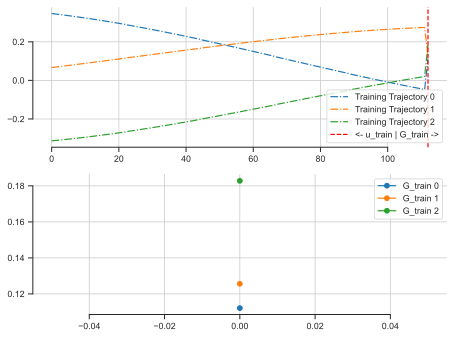

In [8]:
n_datapoints = u_train.shape[1]
separation_idx = n_datapoints

fig,(ax1,ax2) = plt.subplots(2,1)

for row in range(n_init):
    ax1.plot(np.concatenate((u_train[row], G_train[row]), axis=0), "-." ,label = f"Training Trajectory {row}")
    ax2.plot(G_train[row], "-o", label = f"G_train {row}")
ax1.axvline(x=separation_idx, color='r', linestyle='--', label="<- u_train | G_train ->")
ax1.grid()
ax1.legend()
ax2.grid()
ax2.legend()

plt.tight_layout()
sns.despine(trim=True)
plt.show()

# DeepONet Setup

* For increased speed, we also reduce the sensor number of $x_m$ sensors 125 points for the SIR infection rate,.
* In addition to the hyperparameters, we use the ReLu activation function, a learning rate of lr = 0.001, and 1000 epochs for each training procedure. 
* For the SIR search, the same hyperparameters are used with 8 branch layers, 1 redundant trunk layer, and 300 neurons.

### Implementation tips
1. The input function to the DNO should be scaled to vary within values of -1 and 1. 2. 
2. The quantity of interest, or output, should also be scaled and normalized to values between -1 and 1. 3. 
3. Users should ensure that the DNO is indeed fitting the outputs. This is typically observed with final training errors that are multiple orders of magnitude below the initial training error at epoch 0. To adjust, increase training epochs, layers, and/or width of neurons. Otherwise, the scaling above may have not been appropriately performed.

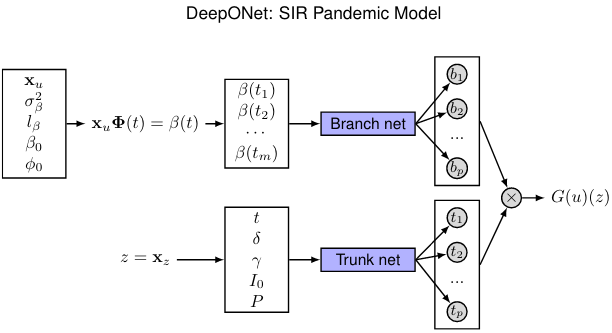

In [9]:
%matplotlib inline
from IPython.display import Image
Image('./DeepONet-SIR Pandemic Model.png')

# DeepONet Training using DeepXDE

In [10]:
import deepxde as dde

m       = int(nsteps/coarse) #604*2
lr      = 0.001
dim_x   = 1
activation = "relu"
branch      = [neurons]*(b_layers+1)
branch[0]   = m
trunk       = [neurons]*(t_layers+1)
trunk[0]    = dim_x

net = dde.maps.DeepONet(
    branch,
    trunk,
    activation,
    "Glorot normal",
)
print(net)

Using backend: pytorch
Other supported backends: tensorflow.compat.v1, tensorflow, jax, paddle.
paddle supports more examples now and is recommended.


DeepONet(
  (branch): FNN(
    (linears): ModuleList(
      (0): Linear(in_features=112, out_features=300, bias=True)
      (1-7): 7 x Linear(in_features=300, out_features=300, bias=True)
    )
  )
  (trunk): FNN(
    (linears): ModuleList(
      (0): Linear(in_features=1, out_features=300, bias=True)
    )
  )
  (b): ParameterList(  (0): Parameter containing: [torch.float32 of size ])
)


In [11]:
# Making Dummy Variable for testing since it is redundant right now
u_test = u_train[0,:].reshape((1,np.size(u_train[0,:]))).astype(np.float32)
y_test = y_train[0,:].reshape((1,np.size(y_train[0,:]))).astype(np.float32)
G_test = G_train[0,:].reshape((1,np.size(G_train[0,:]))).astype(np.float32)
# Report the sizes of the functions
print(np.shape(u_test))
print(np.shape(y_test))
print(np.shape(G_test))

(1, 112)
(1, 1)
(1, 1)


In [12]:
##########################################
# Loop through iterations
##########################################
import scipy
from scipy.interpolate import InterpolatedUnivariateSpline
import scipy.io as sio

from tqdm import trange
from supervisor.supervisor import DeepXDE_DeepONet

# Keeping track of the metric
pys = np.zeros((iters_max,10000))
log10_errors = np.zeros((iters_max,))

for iter_num in trange(0,iters_max):
    # Train the model
    model = DeepXDE_DeepONet(u_train,y_train,G_train,
                             u_test,y_test,G_test,
                             net, noise)
    
    # Pull a fine set of test_pts in the domain
    test_pts = 75
    Theta_test = inputs.draw_samples(test_pts, "grd")
    # Theta_test = inputs.draw_samples(test_pts, init_method)
    # Predict
    Mean_Val, Var_Val = model.predict(Theta_test)

    # Determine Bounds for evaluzting the metric
    x_max = np.max(Mean_Val)
    x_min = np.min(Mean_Val)
    x_int = np.linspace(x_min,x_max,10000) # Linearly space points
    x_int_standard = np.linspace(0,10**8,10000) # Static for pt-wise comparisons

    # Create the weights/exploitation values
    px = inputs.pdf(Theta_test)
    sc = scipy.stats.gaussian_kde(Mean_Val.reshape(test_pts**2,), weights=px)   # Fit a guassian kde using px input weights
    py = sc.evaluate(x_int) # Evaluate at x_int
    py[py<10**-16] = 10**-16 # Eliminate spuriously small values (smaller than numerical precision)
    py_standard = sc.evaluate(x_int_standard) # Evaluate for pt-wise comparisons
    py_interp = InterpolatedUnivariateSpline(x_int, py, k=1) # Create interpolation function

    # Conctruct the weights
    wx = px.reshape(test_pts**2,)/py_interp(Mean_Val).reshape(test_pts**2,)
    wx = wx.reshape(test_pts**2,1)

    # Compute the acquisition values
    ax = wx*Var_Val  # This is simply w(\theta) \sigma^2(\theta) - note that x and \theta are used interchangably
    
    # Find the optimal acquisition point
    Theta_opt = Theta_test[np.argmax(ax),:]
    Theta_opt = Theta_opt.reshape(1,2)     

    # Calculate the associated U
    U_opt = Theta_to_U(noise,Theta_opt,nsteps,1,2)+2.55
    U_opt = U_opt*multiplier
    U_opt = U_opt.reshape(np.size(U_opt),1)

    # Pass to the Map
    I_temp = map_def(U_opt,gamma,delta,N_people,I0,T,dt,np.zeros(np.shape(U_opt)))
    Y_opt = I_temp[-1]
    Y_opt = Y_opt.reshape(1,1)

    # Append the value for the next step
    Theta = np.append(Theta, Theta_opt, axis = 0)
    Y = np.append(Y, Y_opt, axis = 0)
    pys[iter_num,:] = py_standard
    sio.savemat('SIR_Seed_'+str(seed)+'_N'+str(N)+'_iter_'+str(iter_num)+'.mat', {'pys':pys, 'x_int_standard':x_int_standard, 'Theta':Theta, 'U_opt':U_opt, 'I_temp':I_temp, 'wx':wx, 'ax':ax, 'py':py, 'x_int':x_int, 'Y':Y, 'Mean_Val':Mean_Val, 'Var_Val':Var_Val, 'n_init':n_init, 'N':N, 'seed':seed, 'Theta_test':Theta_test})

    if iter_num == 0: # Calulate the truth values
        d = sio.loadmat('./data/truth_data_py.mat')
        py_standard_truth = d['py_standard']
        py_standard_truth = py_standard_truth.reshape(10000,)
    
    log10_error = np.sum(np.abs(np.log10(py_standard[50:2750]) - np.log10(py_standard_truth[50:2750])))/(x_int_standard[2] -x_int_standard[1])  
    log10_errors[iter_num] = log10_error
    print('The log10 of the log-pdf error is: '+str(np.log10(log10_error)))

    # Plot Figures
    if iter_num in [1,5,25,47]:
        fig = plt.figure()
        gs = fig.add_gridspec(2, 3, hspace=0.15, wspace=0.3)
        (ax1, ax2, ax3), (ax4, ax5, ax6) = gs.subplots()#(sharex='col', sharey='row')
        fig.suptitle('2D Stochastic Pandemic Search, Iteration '+str(iter_num))
        ax1.pcolor(Theta_test[:,0].reshape(test_pts, test_pts), Theta_test[:,1].reshape(test_pts, test_pts), Mean_Val.reshape(test_pts, test_pts), cmap="viridis", edgecolors="face")
        ax1.set_aspect('equal')
        ax1.annotate('Mean Solution',
        xy=(-3, 5), xycoords='data',
        xytext=(0.7, 0.95), textcoords='axes fraction',
        horizontalalignment='right', verticalalignment='top',color='white')
        #ax1.set_ylabel('$\theta_2$') 
        
        ax2.pcolor(Theta_test[:,0].reshape(test_pts, test_pts), Theta_test[:,1].reshape(test_pts, test_pts), Var_Val.reshape(test_pts, test_pts), cmap="viridis", edgecolors="face")
        ax2.plot(Theta[0:np.size(Y)-1,0], Theta[0:np.size(Y)-1,1], 'wo')
        ax2.set_aspect('equal')
        ax2.annotate('Variance',
        xy=(-3, 5), xycoords='data',
        xytext=(0.7, 0.95), textcoords='axes fraction',
        horizontalalignment='right', verticalalignment='top',color='white') 
        
        ax3.pcolor(Theta_test[:,0].reshape(test_pts, test_pts), Theta_test[:,1].reshape(test_pts, test_pts), wx.reshape(test_pts, test_pts), cmap="viridis", edgecolors="face")
        ax3.set_aspect('equal')
        ax3.annotate('Danger Scores',
        xy=(-3, 5), xycoords='data',
        xytext=(0.7, 0.95), textcoords='axes fraction',
        horizontalalignment='right', verticalalignment='top',color='white') 
        #ax3.set_ylabel('$\theta_2$') 
        #ax3.set_xlabel('$\theta_1$') 

        ax4.pcolor(Theta_test[:,0].reshape(test_pts, test_pts), Theta_test[:,1].reshape(test_pts, test_pts), ax.reshape(test_pts, test_pts), cmap="viridis", edgecolors="face")
        ax4.plot(Theta[-1,0], Theta[-1,1], 'ro')
        ax4.set_aspect('equal')
        ax4.annotate('Acquisition',
        xy=(-3, 5), xycoords='data',
        xytext=(0.7, 0.95), textcoords='axes fraction',
        horizontalalignment='right', verticalalignment='top',color='white') 
        #ax4.set_xlabel('$\theta_1$')
        ax4.set_xlim([-6,6])
        ax4.set_ylim([-6,6])

        ax5.semilogy(x_int_standard, py_standard_truth, label ='True PDF' )
        ax5.semilogy(x_int_standard, py_standard, label='NN Approx.')
        ax5.set_xlim([0,2.75*10**7])
        ax5.set_ylim([10**-10,10**-6.75])
        ax5.legend(loc='lower left')
        #ax5.annotate('Output PDFs',
        #xy=(-3, 5), xycoords='data',
        #xytext=(0.7, 0.95), textcoords='axes fraction',
        #horizontalalignment='right', verticalalignment='top',color='white') 
        ax5.set_xlabel('New Infections')
        
        ax6.plot(np.linspace(0,iter_num,iter_num+1),np.log10(log10_errors[0:iter_num+1]), label='Error')
        #ax6.annotate('Log10 of log-pdf Error',
        #xy=(-3, 5), xycoords='data',
        #xytext=(0.7, 0.95), textcoords='axes fraction',
        #horizontalalignment='right', verticalalignment='top',color='white')
        ax6.legend(loc='lower left')
        ax6.set_xlabel('Iterations')
        plt.show()
                    
sio.savemat('./data/SIR_Errors_Seed_'+str(seed)+'_N'+str(N)+'.mat', {'log10_errors':log10_errors})


  0%|          | 0/50 [00:00<?, ?it/s]

Compiling model...
'compile' took 3.559755 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.10e-02]    [1.18e-02]    [1.18e-02]    
1000      [3.33e-15]    [5.55e-17]    [5.55e-17]    

Best model at step 1000:
  train loss: 3.33e-15
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.494703 s

Compiling model...
'compile' took 0.001445 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [3.33e-15]    [5.55e-17]    [5.55e-17]    
1000      [3.03e-15]    [7.99e-15]    [7.99e-15]    

Best model at step 1000:
  train loss: 3.03e-15
  test loss: 7.99e-15
  test metric: [7.99e-15]

'train' took 12.159376 s



  2%|▏         | 1/50 [00:33<27:21, 33.51s/it]

The log10 of the log-pdf error is: -0.20395242369786104
Compiling model...
'compile' took 0.000958 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [3.03e-15]    [7.99e-15]    [7.99e-15]    
1000      [7.43e-14]    [2.94e-14]    [2.94e-14]    

Best model at step 0:
  train loss: 3.03e-15
  test loss: 7.99e-15
  test metric: [7.99e-15]

'train' took 14.155179 s

Compiling model...
'compile' took 0.000575 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [7.43e-14]    [2.94e-14]    [2.94e-14]    
1000      [1.01e-09]    [1.57e-09]    [1.57e-09]    

Best model at step 0:
  train loss: 7.43e-14
  test loss: 2.94e-14
  test metric: [2.94e-14]

'train' took 10.547386 s

The log10 of the log-pdf error is: -1.1806711806446082


  4%|▍         | 2/50 [01:08<27:33, 34.44s/it]

Compiling model...
'compile' took 0.001172 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [1.01e-09]    [1.57e-09]    [1.57e-09]    
1000      [9.25e-17]    [5.55e-17]    [5.55e-17]    

Best model at step 1000:
  train loss: 9.25e-17
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 22.218907 s

Compiling model...
'compile' took 0.002151 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [9.25e-17]    [5.55e-17]    [5.55e-17]    
1000      [1.26e-15]    [8.88e-16]    [8.88e-16]    

Best model at step 0:
  train loss: 9.25e-17
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 13.785681 s



  6%|▌         | 3/50 [01:50<29:28, 37.63s/it]

The log10 of the log-pdf error is: -1.4104135134351339
Compiling model...
'compile' took 0.000376 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [1.26e-15]    [8.88e-16]    [8.88e-16]    
1000      [3.89e-16]    [5.55e-17]    [5.55e-17]    

Best model at step 1000:
  train loss: 3.89e-16
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 18.745244 s

Compiling model...
'compile' took 0.000861 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [3.89e-16]    [5.55e-17]    [5.55e-17]    
1000      [5.03e-15]    [2.72e-15]    [2.72e-15]    

Best model at step 0:
  train loss: 3.89e-16
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 26.136511 s



  8%|▊         | 4/50 [02:39<32:32, 42.45s/it]

The log10 of the log-pdf error is: -1.1334298802188136
Compiling model...
'compile' took 0.000389 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [5.03e-15]    [2.72e-15]    [2.72e-15]    
1000      [1.21e-13]    [4.35e-14]    [4.35e-14]    

Best model at step 0:
  train loss: 5.03e-15
  test loss: 2.72e-15
  test metric: [2.72e-15]

'train' took 19.222509 s

Compiling model...
'compile' took 0.000589 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [1.21e-13]    [4.35e-14]    [4.35e-14]    
1000      [1.55e-15]    [2.22e-16]    [2.22e-16]    

Best model at step 1000:
  train loss: 1.55e-15
  test loss: 2.22e-16
  test metric: [2.22e-16]

'train' took 15.112090 s



 10%|█         | 5/50 [03:18<30:41, 40.92s/it]

The log10 of the log-pdf error is: -0.3172970946117227
Compiling model...
'compile' took 0.000343 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [1.55e-15]    [2.22e-16]    [2.22e-16]    
1000      [1.26e-15]    [1.39e-15]    [1.39e-15]    

Best model at step 1000:
  train loss: 1.26e-15
  test loss: 1.39e-15
  test metric: [1.39e-15]

'train' took 17.452759 s

Compiling model...
'compile' took 0.000878 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [1.26e-15]    [1.39e-15]    [1.39e-15]    
1000      [2.08e-14]    [4.50e-15]    [4.50e-15]    

Best model at step 0:
  train loss: 1.26e-15
  test loss: 1.39e-15
  test metric: [1.39e-15]

'train' took 15.206540 s

The log10 of the log-pdf error is: 0.5271051903316885


 12%|█▏        | 6/50 [04:04<31:26, 42.87s/it]

Compiling model...
'compile' took 0.006755 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.08e-14]    [4.50e-15]    [4.50e-15]    
1000      [5.48e-13]    [3.82e-13]    [3.82e-13]    

Best model at step 0:
  train loss: 2.08e-14
  test loss: 4.50e-15
  test metric: [4.50e-15]

'train' took 26.182957 s

Compiling model...
'compile' took 0.000642 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [5.48e-13]    [3.82e-13]    [3.82e-13]    
1000      [2.41e-16]    [5.00e-16]    [5.00e-16]    

Best model at step 1000:
  train loss: 2.41e-16
  test loss: 5.00e-16
  test metric: [5.00e-16]

'train' took 15.902129 s



 14%|█▍        | 7/50 [04:52<31:45, 44.31s/it]

The log10 of the log-pdf error is: 0.8516721768668962
Compiling model...
'compile' took 0.000395 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.41e-16]    [5.00e-16]    [5.00e-16]    
1000      [2.68e-15]    [5.00e-16]    [5.00e-16]    

Best model at step 0:
  train loss: 2.41e-16
  test loss: 5.00e-16
  test metric: [5.00e-16]

'train' took 19.952278 s

Compiling model...
'compile' took 0.000454 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.68e-15]    [5.00e-16]    [5.00e-16]    
1000      [8.18e-09]    [3.29e-09]    [3.29e-09]    

Best model at step 0:
  train loss: 2.68e-15
  test loss: 5.00e-16
  test metric: [5.00e-16]

'train' took 10.280946 s



 16%|█▌        | 8/50 [05:27<29:08, 41.64s/it]

The log10 of the log-pdf error is: 0.9865648225104278
Compiling model...
'compile' took 0.000735 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [8.18e-09]    [3.29e-09]    [3.29e-09]    
1000      [9.07e-16]    [1.39e-15]    [1.39e-15]    

Best model at step 1000:
  train loss: 9.07e-16
  test loss: 1.39e-15
  test metric: [1.39e-15]

'train' took 9.795849 s

Compiling model...
'compile' took 0.000795 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [9.07e-16]    [1.39e-15]    [1.39e-15]    
1000      [7.40e-16]    [0.00e+00]    [0.00e+00]    

Best model at step 1000:
  train loss: 7.40e-16
  test loss: 0.00e+00
  test metric: [0.00e+00]

'train' took 10.318089 s



 18%|█▊        | 9/50 [05:51<24:34, 35.97s/it]

The log10 of the log-pdf error is: 1.08671156240294
Compiling model...
'compile' took 0.000606 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [7.40e-16]    [0.00e+00]    [0.00e+00]    
1000      [3.83e-14]    [5.33e-14]    [5.33e-14]    

Best model at step 0:
  train loss: 7.40e-16
  test loss: 0.00e+00
  test metric: [0.00e+00]

'train' took 18.220384 s

Compiling model...
'compile' took 0.000582 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [3.83e-14]    [5.33e-14]    [5.33e-14]    
1000      [2.18e-08]    [1.42e-08]    [1.42e-08]    

Best model at step 0:
  train loss: 3.83e-14
  test loss: 5.33e-14
  test metric: [5.33e-14]

'train' took 8.433656 s



 20%|██        | 10/50 [06:21<22:45, 34.15s/it]

The log10 of the log-pdf error is: 1.0779754425640835
Compiling model...
'compile' took 0.000715 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.18e-08]    [1.42e-08]    [1.42e-08]    
1000      [9.25e-17]    [0.00e+00]    [0.00e+00]    

Best model at step 1000:
  train loss: 9.25e-17
  test loss: 0.00e+00
  test metric: [0.00e+00]

'train' took 13.604256 s

Compiling model...
'compile' took 0.000666 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [9.25e-17]    [0.00e+00]    [0.00e+00]    
1000      [2.52e-14]    [1.80e-14]    [1.80e-14]    

Best model at step 0:
  train loss: 9.25e-17
  test loss: 0.00e+00
  test metric: [0.00e+00]

'train' took 9.087060 s



 22%|██▏       | 11/50 [06:47<20:37, 31.72s/it]

The log10 of the log-pdf error is: 1.0852577182139191
Compiling model...
'compile' took 0.000580 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.52e-14]    [1.80e-14]    [1.80e-14]    
1000      [2.41e-16]    [5.00e-16]    [5.00e-16]    

Best model at step 1000:
  train loss: 2.41e-16
  test loss: 5.00e-16
  test metric: [5.00e-16]

'train' took 9.118755 s

Compiling model...
'compile' took 0.000451 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.41e-16]    [5.00e-16]    [5.00e-16]    
1000      [2.16e-15]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 2.41e-16
  test loss: 5.00e-16
  test metric: [5.00e-16]

'train' took 8.242173 s



 24%|██▍       | 12/50 [07:08<18:00, 28.45s/it]

The log10 of the log-pdf error is: 1.1119310802578113
Compiling model...
'compile' took 0.000558 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [2.16e-15]    [5.55e-17]    [5.55e-17]    
1000      [8.43e-10]    [4.66e-10]    [4.66e-10]    

Best model at step 0:
  train loss: 2.16e-15
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 15.370015 s

Compiling model...
'compile' took 0.000524 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [8.43e-10]    [4.66e-10]    [4.66e-10]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 1000:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 18.617407 s



 26%|██▌       | 13/50 [07:46<19:19, 31.34s/it]

The log10 of the log-pdf error is: 1.118246798298075
Compiling model...
'compile' took 0.000520 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 19.312052 s

Compiling model...
'compile' took 0.000714 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 16.170166 s



 28%|██▊       | 14/50 [08:26<20:17, 33.83s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000689 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 22.180477 s

Compiling model...
'compile' took 0.000561 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 18.322874 s



 30%|███       | 15/50 [09:12<21:58, 37.67s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000482 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 15.896684 s

Compiling model...
'compile' took 0.000583 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.492678 s



 32%|███▏      | 16/50 [09:43<20:09, 35.57s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000486 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 15.973207 s

Compiling model...
'compile' took 0.000711 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.973224 s



 34%|███▍      | 17/50 [10:14<18:51, 34.30s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000545 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 12.323199 s

Compiling model...
'compile' took 0.000716 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 25.254516 s



 36%|███▌      | 18/50 [10:57<19:37, 36.79s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000595 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 11.469005 s

Compiling model...
'compile' took 0.006976 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.044845 s



 38%|███▊      | 19/50 [11:21<17:02, 32.99s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000498 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.868076 s

Compiling model...
'compile' took 0.000419 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 43.788203 s



 40%|████      | 20/50 [9:28:54<83:53:25, 10066.85s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000702 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 24.812203 s

Compiling model...
'compile' took 0.000641 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.459310 s



 42%|████▏     | 21/50 [12:33:37<83:33:06, 10371.96s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.113843 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 86.484984 s

Compiling model...
'compile' took 0.004753 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 22.730269 s



 44%|████▍     | 22/50 [20:50:57<126:06:50, 16214.64s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000535 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 11.046819 s

Compiling model...
'compile' took 0.003401 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 13.273499 s



 46%|████▌     | 23/50 [20:51:30<85:11:31, 11358.94s/it] 

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000553 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 52.837994 s

Compiling model...
'compile' took 0.000892 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.325913 s



 48%|████▊     | 24/50 [20:52:37<57:33:59, 7970.73s/it] 

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000555 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.832770 s

Compiling model...
'compile' took 0.000571 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.595461 s



 50%|█████     | 25/50 [20:52:58<38:47:18, 5585.54s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000445 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.969387 s

Compiling model...
'compile' took 0.001324 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.014424 s

The log10 of the log-pdf error is: 1.1149042353672818


 52%|█████▏    | 26/50 [20:53:28<26:07:23, 3918.47s/it]

Compiling model...
'compile' took 0.000911 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 17.205335 s

Compiling model...
'compile' took 0.001229 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 13.423399 s



 54%|█████▍    | 27/50 [20:54:04<17:35:33, 2753.62s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000624 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 11.145567 s

Compiling model...
'compile' took 0.000682 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.762660 s



 56%|█████▌    | 28/50 [20:54:29<11:49:30, 1935.04s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000533 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.015720 s

Compiling model...
'compile' took 0.004191 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.545727 s



 58%|█████▊    | 29/50 [20:54:56<7:56:57, 1362.73s/it] 

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000680 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.917052 s

Compiling model...
'compile' took 0.002959 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.912963 s



 60%|██████    | 30/50 [20:55:20<5:20:20, 961.03s/it] 

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000447 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 11.615453 s

Compiling model...
'compile' took 0.000318 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.384554 s



 62%|██████▏   | 31/50 [20:55:45<3:35:23, 680.20s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000559 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.551546 s

Compiling model...
'compile' took 0.001004 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.754506 s



 64%|██████▍   | 32/50 [20:56:08<2:24:58, 483.24s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000682 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.627551 s

Compiling model...
'compile' took 0.000658 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.221851 s



 66%|██████▌   | 33/50 [20:56:33<1:37:53, 345.48s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000398 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.350579 s

Compiling model...
'compile' took 0.000616 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.841062 s



 68%|██████▊   | 34/50 [20:56:56<1:06:20, 248.77s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000533 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.323692 s

Compiling model...
'compile' took 0.000555 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 20.170004 s



 70%|███████   | 35/50 [20:57:35<46:29, 185.95s/it]  

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.001364 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 17.804460 s

Compiling model...
'compile' took 0.000581 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 16.452612 s



 72%|███████▏  | 36/50 [20:58:14<33:05, 141.82s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.001320 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 16.549239 s

Compiling model...
'compile' took 0.002067 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 16.667424 s



 74%|███████▍  | 37/50 [20:58:52<23:57, 110.60s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000579 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 17.090951 s

Compiling model...
'compile' took 0.001276 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 15.399435 s



 76%|███████▌  | 38/50 [20:59:29<17:43, 88.63s/it] 

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000692 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 19.771433 s

Compiling model...
'compile' took 0.001355 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 18.986044 s



 78%|███████▊  | 39/50 [21:00:14<13:51, 75.61s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000702 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 20.537276 s

Compiling model...
'compile' took 0.000836 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 23.760177 s



 80%|████████  | 40/50 [21:01:07<11:26, 68.64s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.001568 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 21.077872 s

Compiling model...
'compile' took 0.001797 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 20.265735 s



 82%|████████▏ | 41/50 [21:01:54<09:21, 62.35s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000905 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 20.055280 s

Compiling model...
'compile' took 0.001403 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.333540 s



 84%|████████▍ | 42/50 [21:02:28<07:10, 53.80s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000680 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.467370 s

Compiling model...
'compile' took 0.000503 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 8.331005 s



 86%|████████▌ | 43/50 [21:18:31<38:05, 326.50s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000339 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 7.779710 s

Compiling model...
'compile' took 0.000443 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 7.061767 s



 88%|████████▊ | 44/50 [21:18:49<23:24, 234.03s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000354 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 7.506415 s

Compiling model...
'compile' took 0.000496 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 7.514538 s



 90%|█████████ | 45/50 [21:35:36<38:49, 465.97s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.001174 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 12.449588 s

Compiling model...
'compile' took 0.001118 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 10.617133 s



 92%|█████████▏| 46/50 [21:36:03<22:17, 334.32s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000378 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 16.650638 s

Compiling model...
'compile' took 0.000429 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.406409 s



 94%|█████████▍| 47/50 [21:36:33<12:08, 242.94s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.000745 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 7.995041 s

Compiling model...
'compile' took 0.000422 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 9.127975 s

The log10 of the log-pdf error is: 1.1149042353672818


 96%|█████████▌| 48/50 [21:37:02<05:57, 178.78s/it]

Compiling model...
'compile' took 0.001002 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.579263 s

Compiling model...
'compile' took 0.001104 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 14.110222 s



 98%|█████████▊| 49/50 [21:37:36<02:15, 135.27s/it]

The log10 of the log-pdf error is: 1.1149042353672818
Compiling model...
'compile' took 0.001006 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 12.753545 s

Compiling model...
'compile' took 0.000660 s

Training model...

Step      Train loss    Test loss     Test metric   
0         [0.00e+00]    [5.55e-17]    [5.55e-17]    
1000      [0.00e+00]    [5.55e-17]    [5.55e-17]    

Best model at step 0:
  train loss: 0.00e+00
  test loss: 5.55e-17
  test metric: [5.55e-17]

'train' took 11.423472 s



100%|██████████| 50/50 [21:38:06<00:00, 1557.72s/it]

The log10 of the log-pdf error is: 1.1149042353672818


## True Values

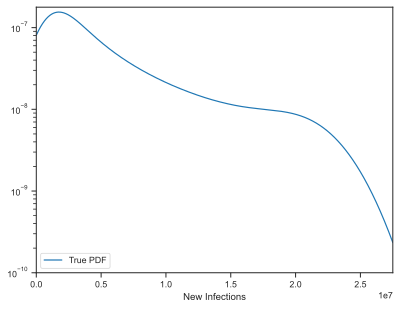

In [13]:
from scipy.io import loadmat

# Load data from .mat file
truth_data = loadmat('./data/truth_data.mat')

# Accessing data
truth_data.keys()

fig, ax = plt.subplots()
ax.semilogy(truth_data["x_int_standard"].reshape(10000), truth_data["py_standard"].reshape(10000), label ='True PDF' )
ax.set_xlim([0,2.75*10**7])
ax.set_ylim([10**-10,10**-6.75])
ax.legend(loc='lower left')
ax.set_xlabel('New Infections');

In [14]:
fig, ax = plt.subplots()
ax.pcolormesh(truth_data["Theta"][:,0].reshape(150, 150), truth_data["Theta"][:,1].reshape(150, 150), truth_data["wx"].reshape(150, 150),cmap="viridis", edgecolors="face")
ax.set_aspect('equal')
ax.annotate('Danger Scores',
xy=(-3, 5), xycoords='data',
xytext=(0.7, 0.95), textcoords='axes fraction',
horizontalalignment='right', verticalalignment='top',color='white') 
ax.set_ylabel('$\\theta_{2}$') 
ax.set_xlabel('$\\theta_{1}$');